## Advanced Lane Finding Project

The goals / steps of this project are the following:

* [Step 1](#step1): Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* [Step 2](#step2): Apply a distortion correction to raw images.
* [Step 3](#step3): Use color transforms, gradients, etc., to create a thresholded binary image.
* [Step 4](#step4): Apply a perspective transform to rectify binary image ("birds-eye view").
* [Step 5](#step5): Detect lane pixels and fit to find the lane boundary.
* [Step 6](#step6): Determine the curvature of the lane and vehicle position with respect to center.
* [Step 7](#step7): Warp the detected lane boundaries back onto the original image.
* [Step 8](#step8): Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

[//]: # (Image References)

[image1]: ../examples/undistort_output.png "Undistorted"
[image2]: ../test_images/test1.jpg "Road Transformed"
[image3]: ../examples/binary_combo_example.jpg "Binary Example"
[image4]: ../examples/warped_straight_lines.jpg "Warp Example"
[image5]: ../examples/color_fit_lines.jpg "Fit Visual"
[image6]: ../examples/example_output.jpg "Output"
[video1]: ../project_video.mp4 "Video"


---
## Camera Calibration

<a id='step1'></a>
### Step 1 Compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
from PIL import Image

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image. Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image. `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.

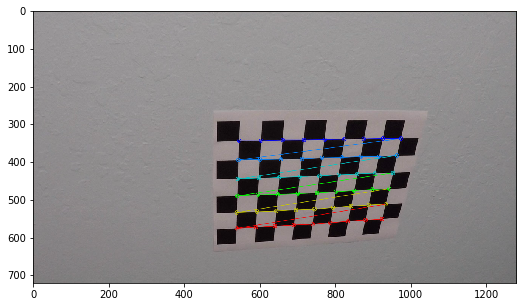

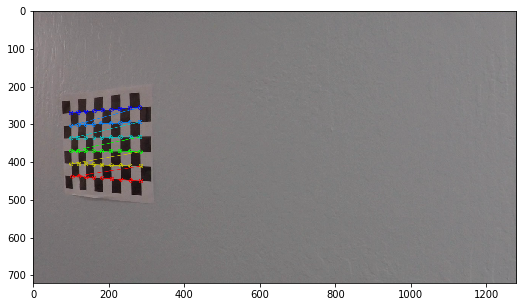

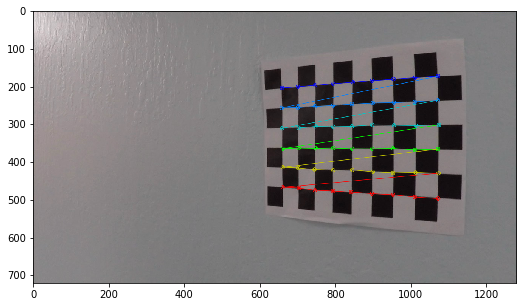

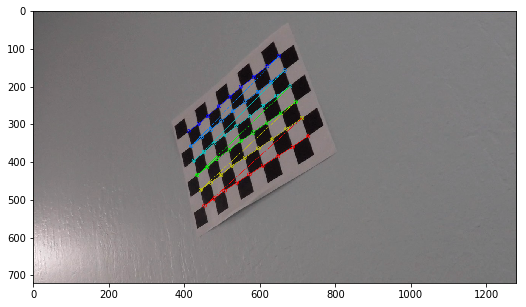

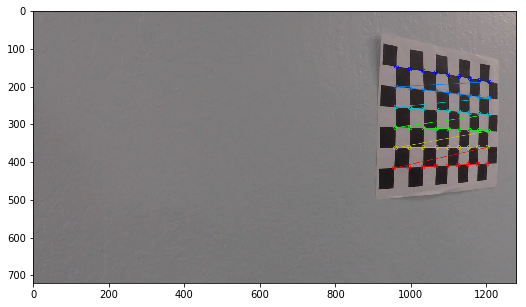

...

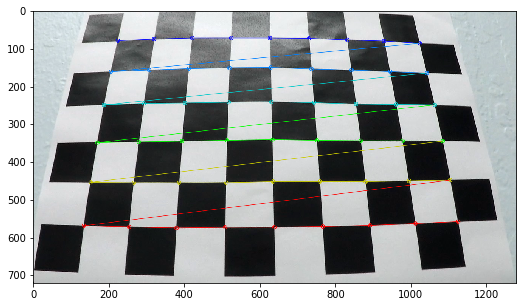

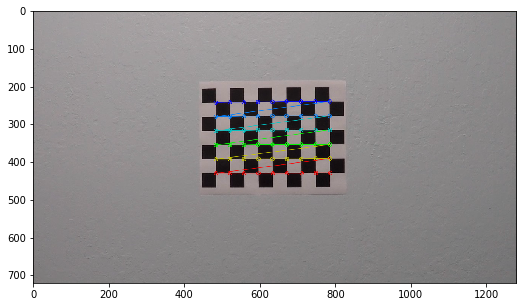

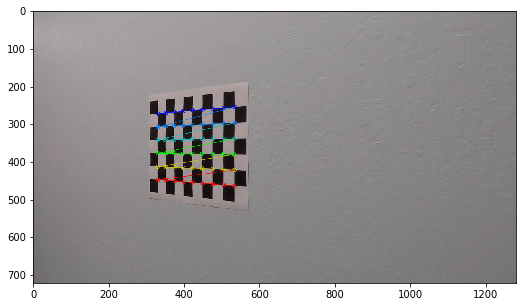

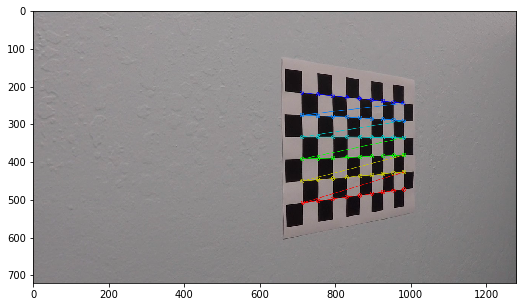

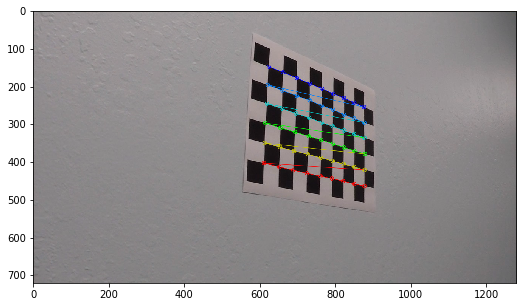

In [2]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    image = cv2.imread(fname)
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        image = cv2.drawChessboardCorners(image, (9,6), corners, ret)
        plt.figure(figsize=(12,5))
        plt.imshow(image)

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function. I applied this distortion correction to the test image using the `cv2.undistort()` function and obtained this result:

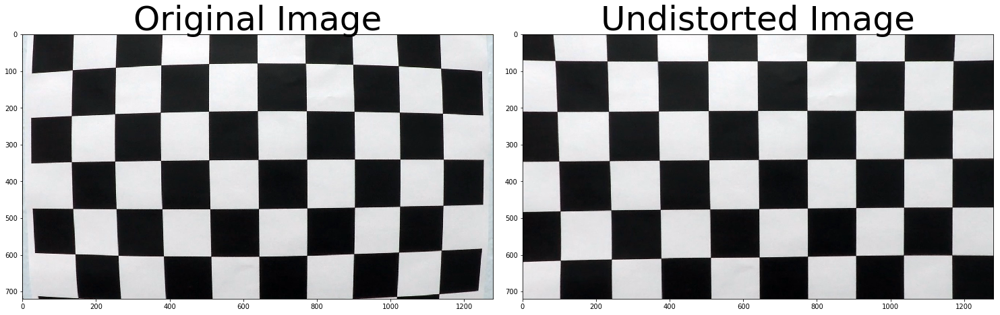

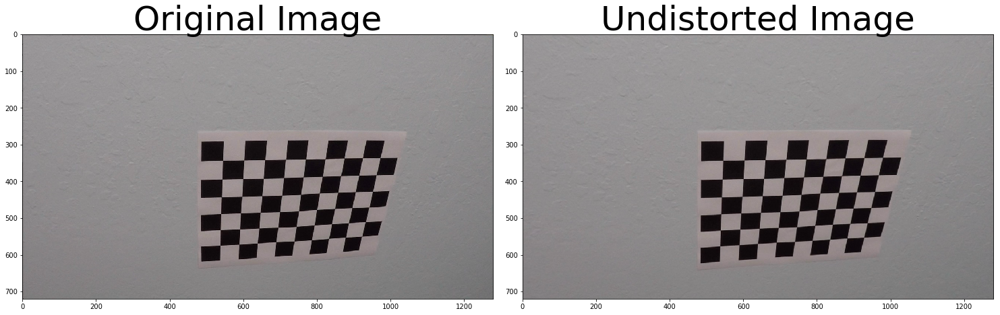

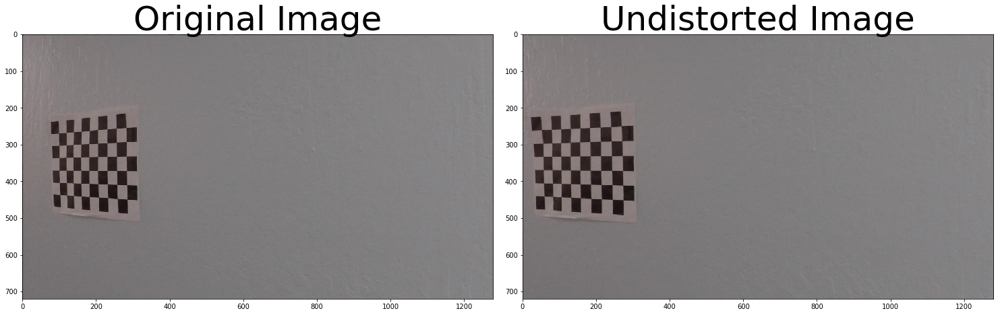

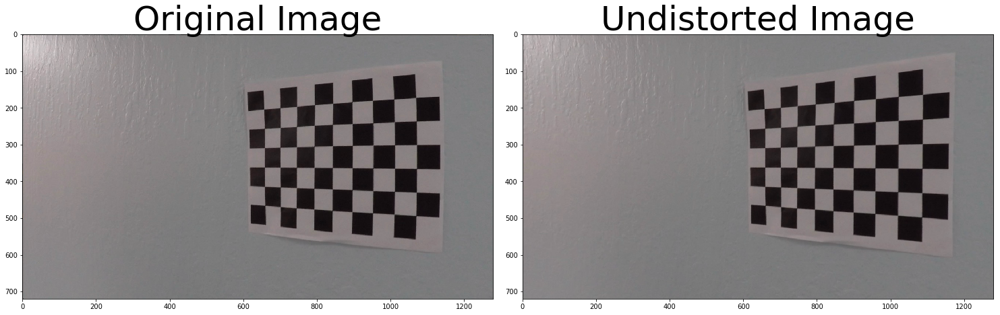

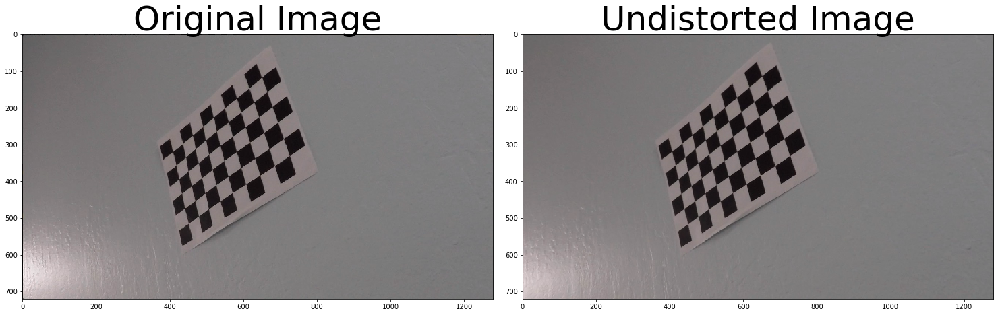

...

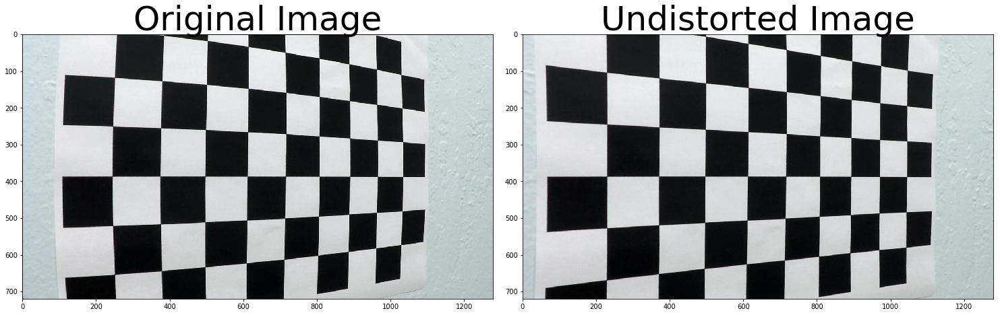

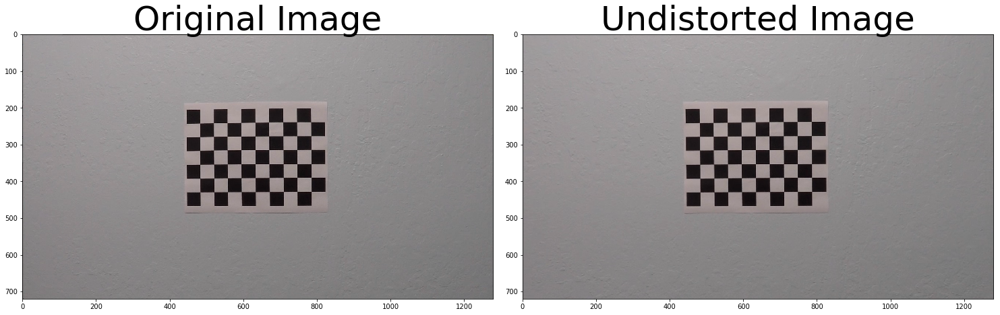

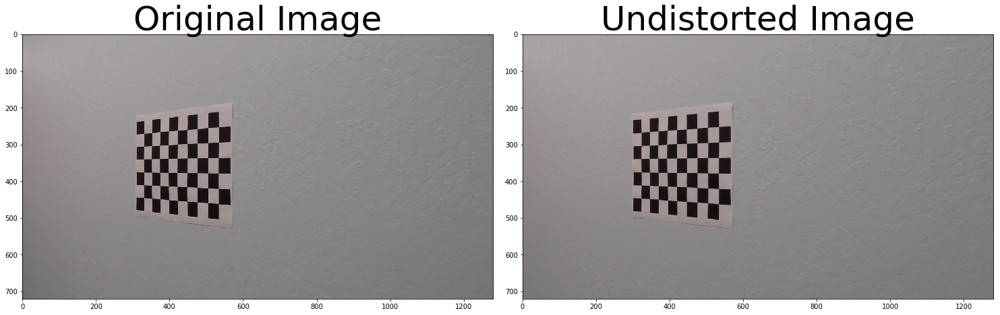

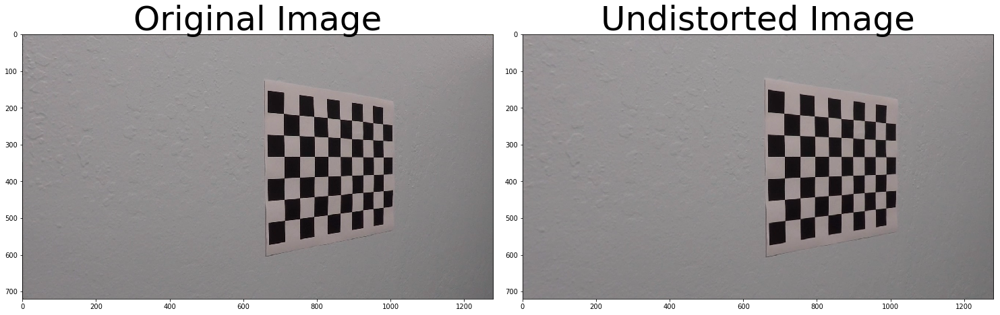

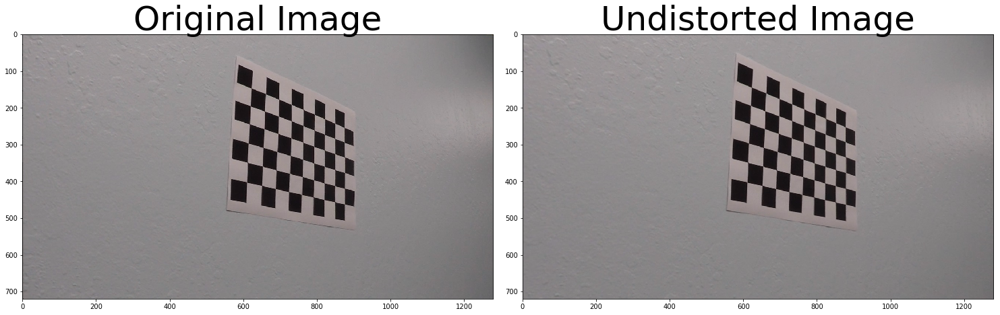

In [3]:
# Write a function that takes an image, object points, and image points
# performs the camera calibration, image distortion correction and 
# returns the undistorted image
def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

for fname in images:
    image = cv2.imread(fname)
    undistorted = cal_undistort(image, objpoints, imgpoints)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 20))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---
## Pipeline (single images)
<a id='step2'></a>
### Step 2 Apply a distortion correction to raw images

In this step, I computed the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` from  `objpoints` and `imgpoints` the I applied the distortion correction to the test images using the `cv2.undistort()` function.

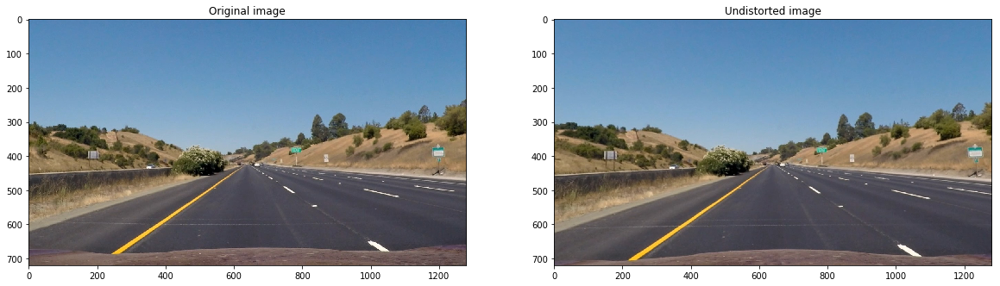

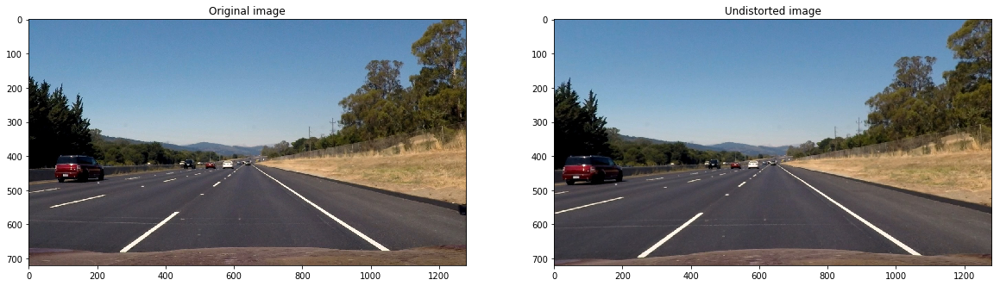

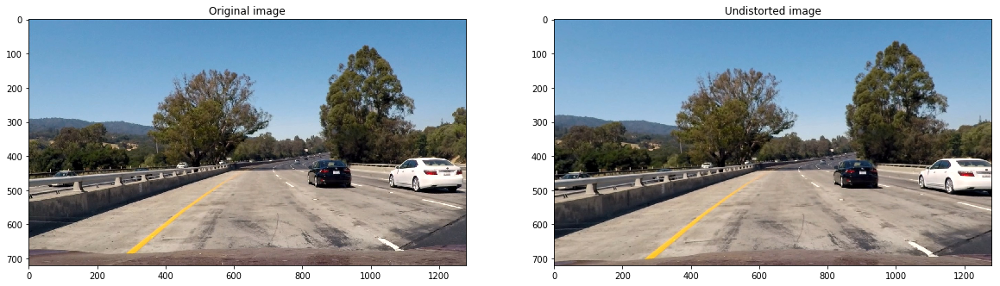

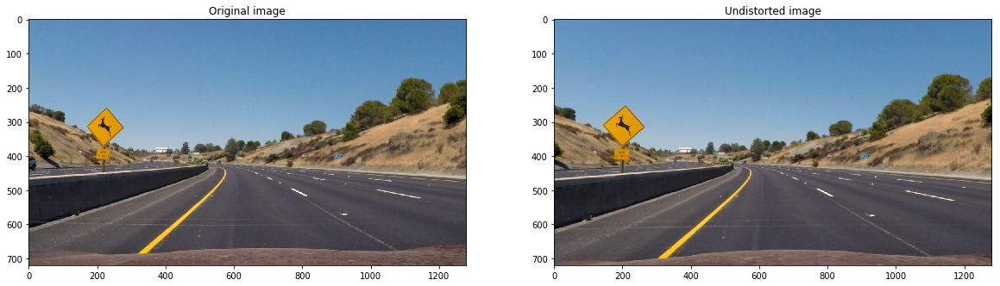

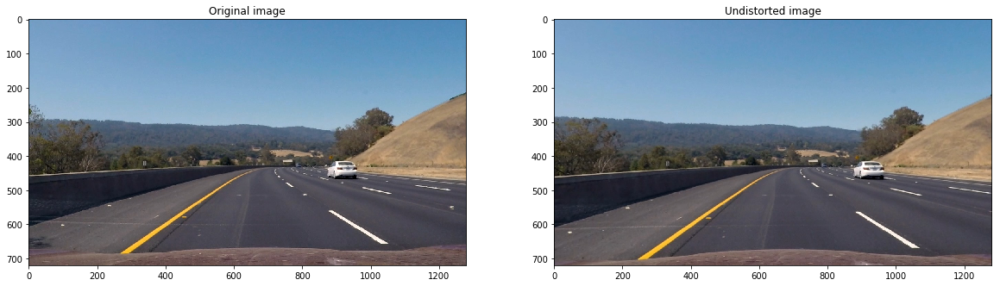

...

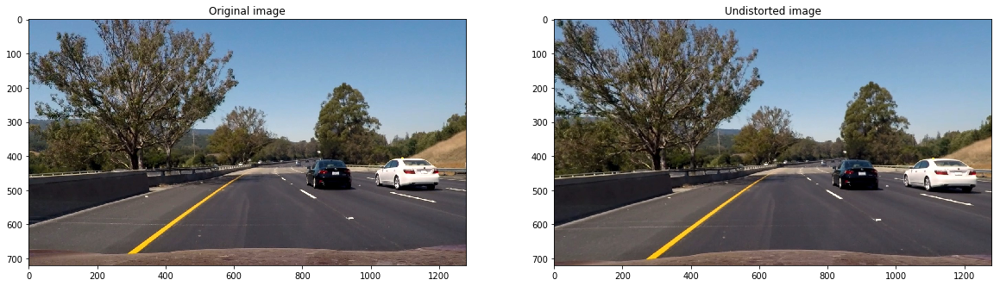

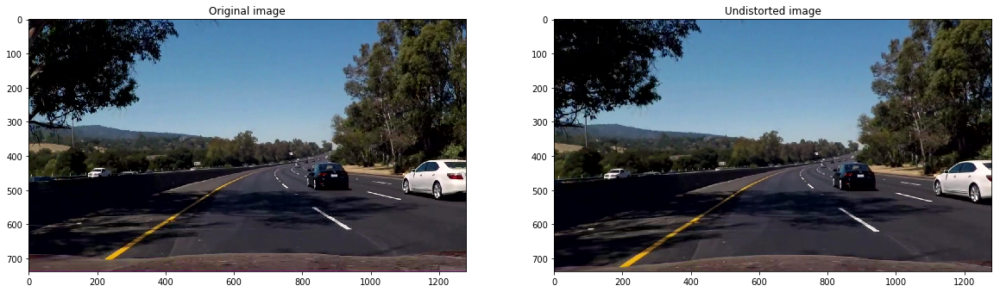

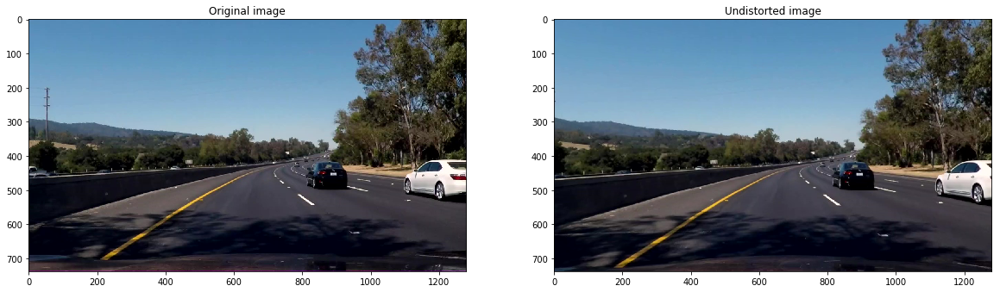

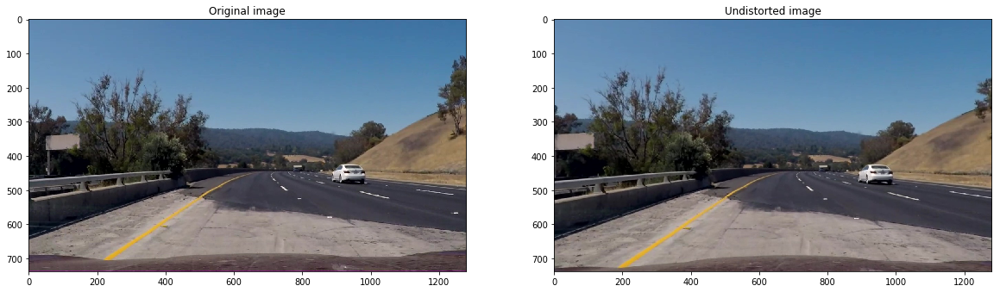

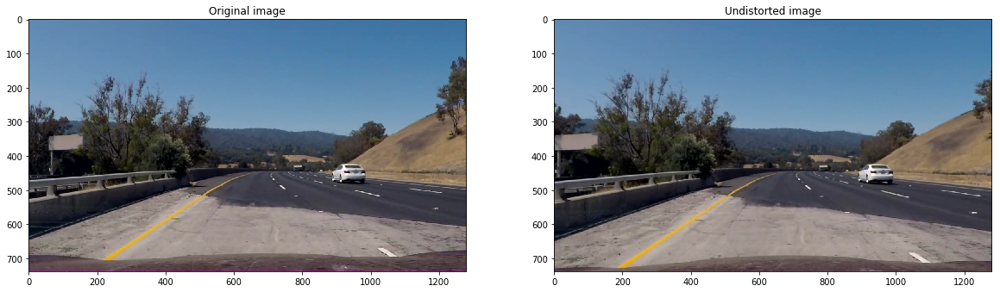

In [4]:
images = glob.glob('../test_images/*.jpg')

# Step through the list and undistort
for fname in images:
    img = mpimg.imread(fname)   

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)

    name, ext = os.path.splitext(os.path.basename(fname))    
    im = Image.fromarray(undist)
    im.save(''.join(['../output_images/undist_', name, '.jpg']))  
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,20))
    ax1.set_title('Original image')
    ax1.imshow(img)

    ax2.set_title('Undistorted image')
    ax2.imshow(undist)

<a id='step3'></a>
### Step 3 Use color transforms, gradients, etc., to create a thresholded binary image

I used a combination of color and gradient thresholds to generate a binary image. The undistorted image was transformed from RGB color space to different color spaces to separate desired color channels because the research showed that grayscale image losses a lot of information. Since the lightness (or intensity) keeps most of the image information, I tested with intensity channels in HSV, LUV or LAB color spaces and to detect the yellow line I used B-channel of LAB color space. V-channel of HSV color space was input to the sobel edge detection using gradient. Only gradient w.r.t x direction was deployed because want to emphasis on vertical edges.

The combination of color and gradient thresholdings was deployed using the `pipeline()` function as below. Other gradient thresholding and color tranform functions are provided in the lectures for reference.

In [5]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Calculate directional gradient then Apply threshold
    # Apply the following steps to img
    # 1) Convert to grayscale
    # gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobel = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    if orient == 'y':
        sobel = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.sqrt(sobel**2)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary_output = np.zeros_like(scaled_sobel)     
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1       
    # 6) Return this mask as your binary_output image
    return binary_output

def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    # Calculate gradient magnitude
    # Apply threshold
    # Apply the following steps to img
    # 1) Convert to grayscale
    #gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    mag = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    max = np.max(mag/255)
    scaled = np.uint8(mag/max)
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(scaled)
    binary_output[(scaled >= thresh[0]) & (scaled <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    #binary_output = np.copy(img) # Remove this line
    return binary_output       
    
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Calculate gradient direction
    # Apply threshold    
    # Apply the following steps to img
    # 1) Convert to grayscale
    #gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.sqrt(sobelx**2)
    abs_sobely = np.sqrt(sobely**2)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(direction)
    binary_output[(direction >= thresh[0]) & (direction <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # 2) Apply a threshold to the S channel
    s_channel = hls[:,:,2]  
    # 3) Return a binary image of threshold result
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output


def pipeline(img, s_thresh=(170, 255), l_thresh=(190, 255), b_thresh=(150, 255), \
             sobel_kernel=9, sx_thresh=(20, 100), sm_thresh=(30, 100), sd_thresh=(0.7, 1.3)):
    img = np.copy(img)
    # Convert to HLS color space and separate the V channel    
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV).astype(np.float)
    s_channel = hsv[:,:,1]
    v_channel = hsv[:,:,2]
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB).astype(np.float)
    l_channel = lab[:,:,0]
    b_channel = lab[:,:,2]
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Threshold color channel
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    # Threshold color channel
    b_binary = np.zeros_like(b_channel)
    b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1
    
    # Sobel x
    #sobelx = cv2.Sobel(v_channel, cv2.CV_64F, 1, 0, ksize=sobel_kernel) # Take the derivative in x
    #abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    #scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    #sxbinary = np.zeros_like(scaled_sobel)
    #sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    sxbinary = abs_sobel_thresh(v_channel, orient='x', sobel_kernel=sobel_kernel, thresh=sx_thresh)
    smbinary = mag_thresh(v_channel, sobel_kernel=sobel_kernel, thresh=sm_thresh)
    sdbinary = dir_threshold(v_channel, sobel_kernel=sobel_kernel, thresh=sd_thresh)
    
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    color_binary = np.uint8(np.dstack((b_binary, l_binary, ((sxbinary == 1) & (smbinary == 1) & (sdbinary == 1)))) * 255)
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(b_binary == 1) | (l_binary == 1) | ((sxbinary == 1) & (smbinary == 1) & (sdbinary == 1))] = 1
    return color_binary, combined_binary

Undistorted images are used to create thresholded binary images. Here, I plotted color_binary images with thresholds stacked in R, G, B channels. The combine thresholded binary images also were presented.

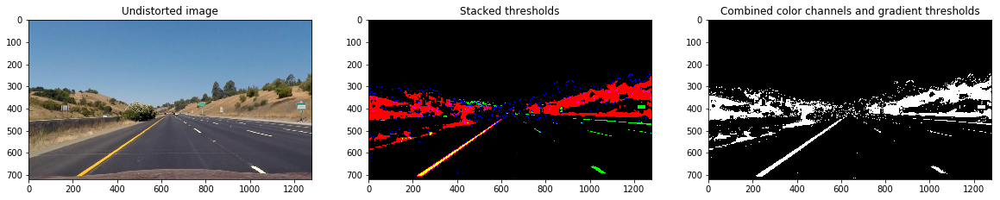

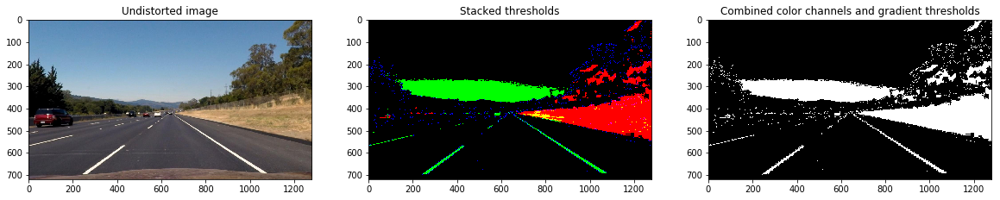

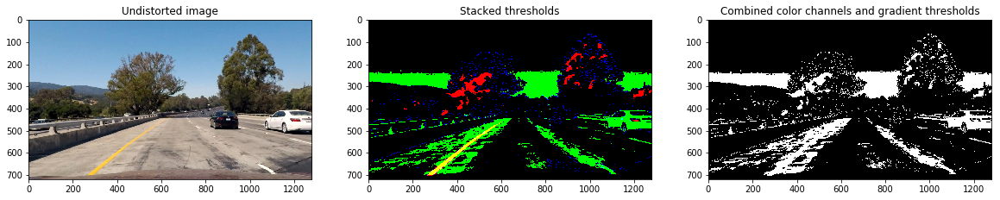

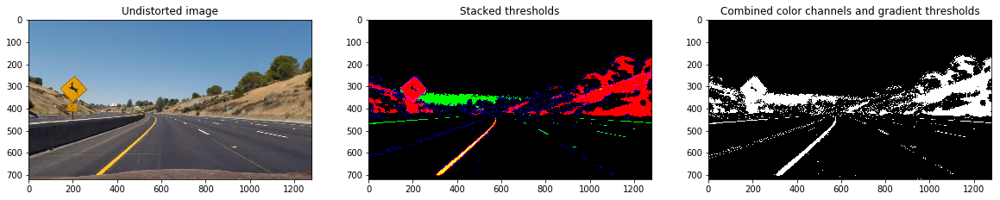

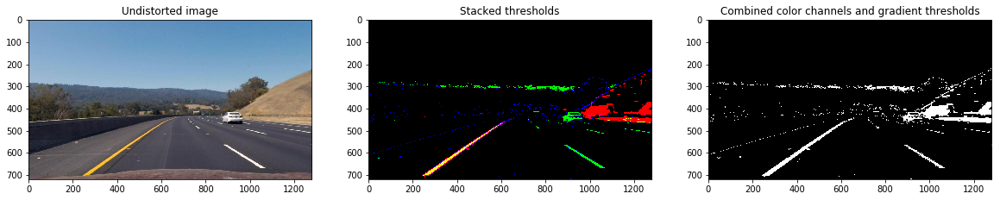

...

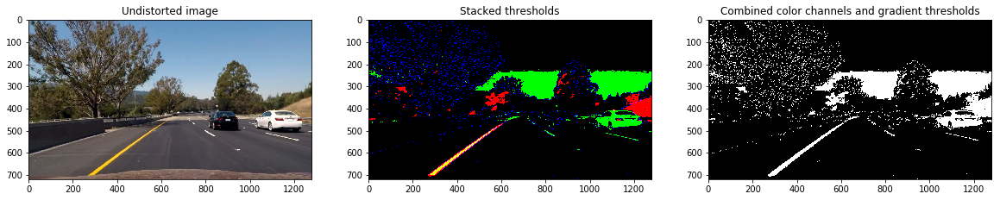

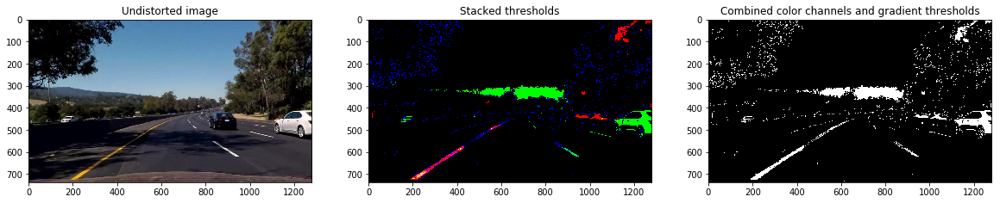

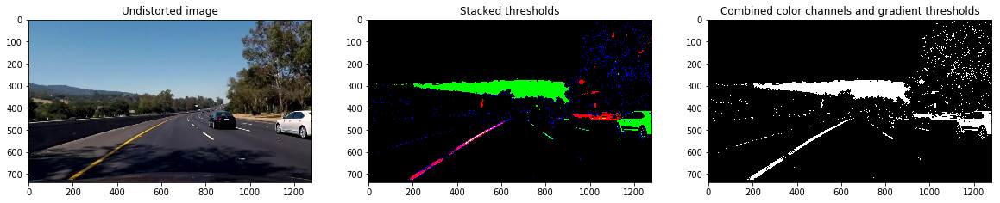

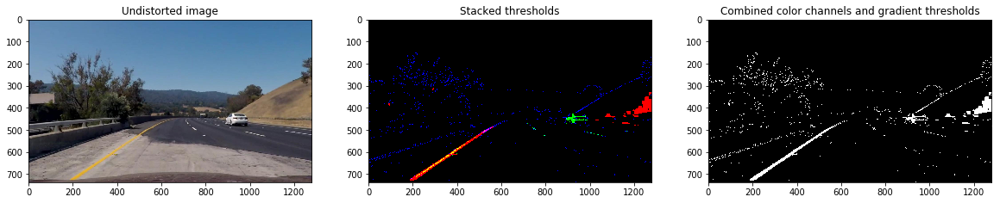

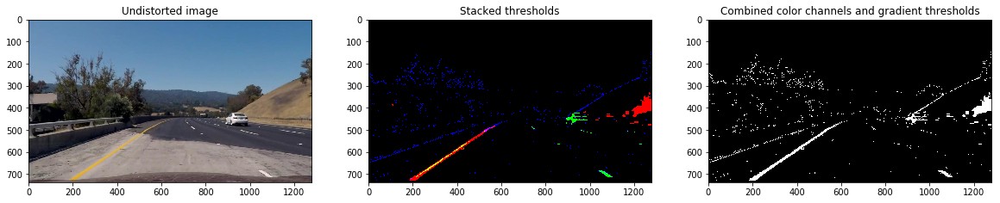

In [6]:
# Make a list of undistorted images
images = glob.glob('../output_images/undist_*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = mpimg.imread(fname)   
    name, ext = os.path.splitext(os.path.basename(fname))

    # Step 3: Use color transforms, gradients, etc., to create a thresholded binary image

    # Choose a Sobel kernel size
    ksize = 5 # Choose a larger odd number to smooth gradient measurements

    color_binary, combined_binary = pipeline(img, sobel_kernel=ksize)   
    combined_binary = np.uint8(combined_binary * 255)

    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,20))
    ax1.set_title('Undistorted image')
    ax1.imshow(img)

    ax2.set_title('Stacked thresholds')
    ax2.imshow(color_binary)

    ax3.set_title('Combined color channels and gradient thresholds')
    ax3.imshow(combined_binary, cmap='gray')
  
    im = Image.fromarray(combined_binary)
    im.save(''.join(['../output_images/combined_', name, '.jpg'])) 

##### <a id='step4'></a>
### Step 4 Apply a perspective transform to rectify binary image ("birds-eye view")

Here, I describe how to perform a perspective transform and provide an example of a transformed image.

The code for my perspective transform includes a function called `warper()`. The warper() function takes as inputs an image (img), as well as source (src) and destination (dst) points. I chose the hardcode the source and destination points in the following manner:

```python
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 40, img_size[1]],
    [(img_size[0] / 2 + 60), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 5), 0],
    [(img_size[0] / 5), img_size[1]],
    [(img_size[0] * 4 / 5), img_size[1]],
    [(img_size[0] * 4 / 5), 0]])
```

This resulted in the following source and destination points:

| Source        | Destination   | 
|:-------------:|:-------------:| 
| 585, 460      | 256, 0        | 
| 203, 720      | 256, 720      |
| 1107, 720     | 1024, 720      |
| 700, 460      | 1024, 0        |

I verified that my perspective transform was working as expected by drawing the src and dst points onto a test image and its warped counterpart to verify that the lines appear parallel in the warped image.

In [7]:
# camera matrix and distortion coefficients
def warper(img, src, dst):
    """
    Define a function that takes an image, number of src and dst points,
    To get the Perspective Transform matrix and    
    Warp an undistorted matrix
    """     
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]))

    # Return the resulting image and matrix
    return warped, M

def draw_region(img, vertices, α=1., β=0.8, λ=0.):
    """
    Draw the region defined by vertices on the input image
    The result image is computed as follows:    
    region * α + img * β + λ
    """ 
    region = np.copy(img)*0 
    for i in range(0,3):
        cv2.line(region,tuple(vertices[i]),tuple(vertices[i+1]),(0,0,255),5) #draw lines with blue and size = 10
    cv2.line(region,tuple(vertices[3]),tuple(vertices[0]),(0,0,255),5)

    return cv2.addWeighted(region, α, img, β, λ)



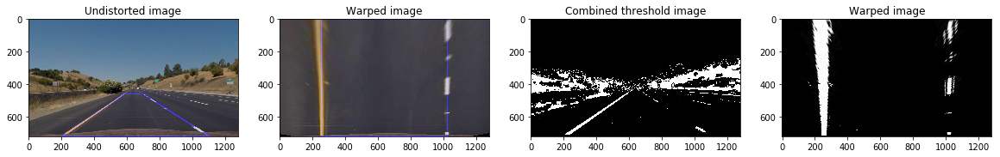

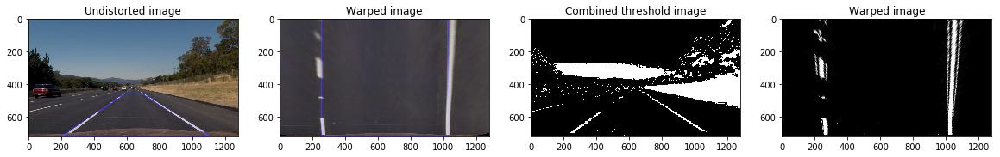

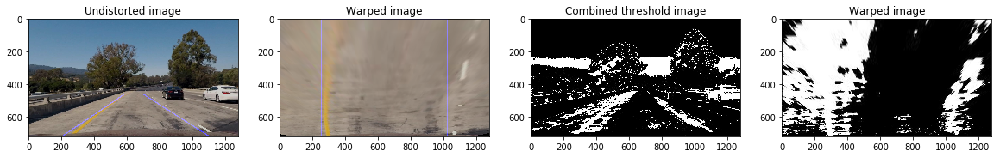

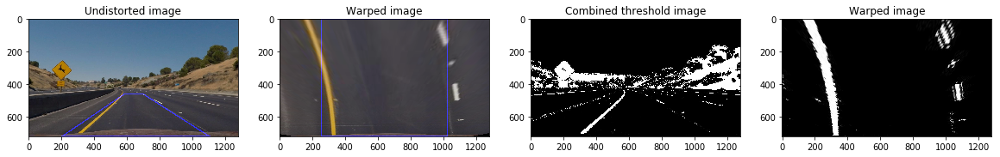

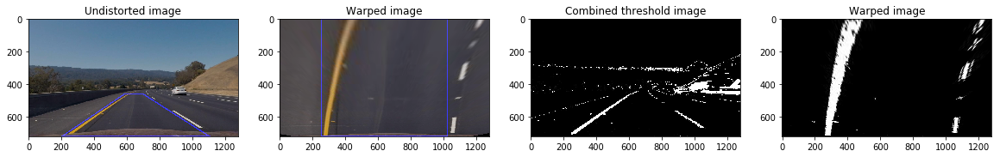

...

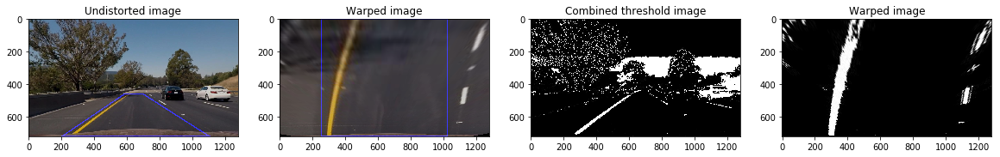

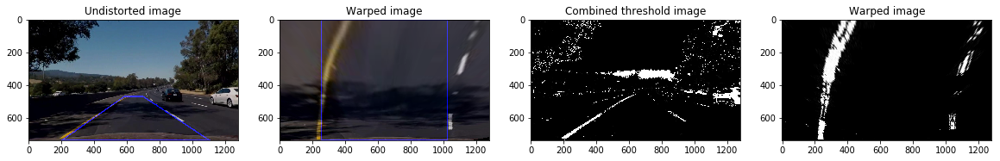

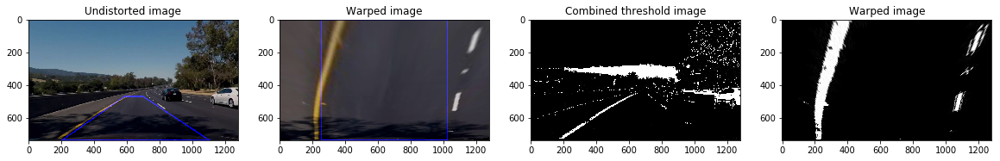

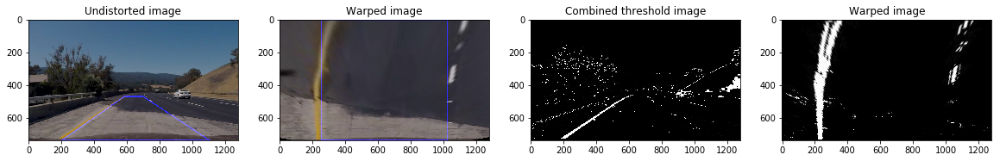

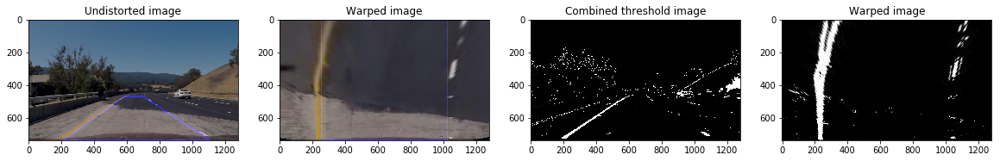

In [8]:
images = glob.glob('../output_images/undist_*.jpg')
images_combined = glob.glob('../output_images/combined_*.jpg')

# Step through the list and apply perspective transform
for fname, fname_combined in zip(images,images_combined):
    # Read undistorted image
    img = mpimg.imread(fname) 
    # Define source and destination points for perfective transform
    img_size = (img.shape[1], img.shape[0])  
    
    src = np.float32(
        [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
        [((img_size[0] / 6) - 10), img_size[1]],
        [(img_size[0] * 5 / 6) + 40, img_size[1]],
        [(img_size[0] / 2 + 60), img_size[1] / 2 + 100]])
    dst = np.float32(
        [[(img_size[0] / 5), 0],
        [(img_size[0] / 5), img_size[1]],
        [(img_size[0] * 4 / 5), img_size[1]],
        [(img_size[0] * 4 / 5), 0]])

    # Perfective transform
    warped, perspective_M = warper(img, src, dst)

    name, ext = os.path.splitext(os.path.basename(fname))    
    im = Image.fromarray(warped)
    im.save(''.join(['../output_images/warped_', name, '.jpg'])) 

    vertices_src = np.array(src, dtype=np.int32)
    region_img = draw_region(img, vertices_src)
    
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20,20))
    ax1.set_title('Undistorted image')
    ax1.imshow(region_img)

    vertices_dst = np.array(dst, dtype=np.int32)  
    region_warped = draw_region(warped, vertices_dst)
    
    ax2.set_title('Warped image')
    ax2.imshow(region_warped)
    
    img_combined = mpimg.imread(fname_combined) 
       
    warped_combined, perspective_M = warper(img_combined, src, dst)

    name, ext = os.path.splitext(os.path.basename(fname_combined))    
    im = Image.fromarray(warped_combined)
    im.save(''.join(['../output_images/warped_', name, '.jpg'])) 
    
    ax3.set_title('Combined threshold image')
    ax3.imshow(img_combined, cmap='gray')
    
    ax4.set_title('Warped image')
    ax4.imshow(warped_combined, cmap='gray')

    

<a id='step5'></a>
### Step 5 Detect lane pixels and fit to find the lane boundary

After having threshold warped image which showed the lane lines clearly, I still needed to determine which pixels belong to the left line and which belong to the right line. Since the threshold warped image was only 1 or 0, using the peak detection from the histogram of the image could get the base of the lane lines. I only took the histogram along all columns in the lower half of the image to remove redundant information of the upper half which contained sky, tree, or building etc. Then I applied sliding window search arround the line center to find and follow the lines up to the top of the image.
 
After having pixels of left and right lines, I fitted a second order polynomial to each line using `polyfit()` function to get the left and right lane boundary. Here, I fitted for f(y), rather than f(x), because the lane lines in the warped image are near vertical and may have the same x value for more than one y value.

The first part of the `detect_lane()` function below checked if the image is the first frame or not. If yes, it did a blind search from the peaks of histogram. If no, it only searched around the line from previous frame within a margin.


<a id='step6'></a>
### Step 6 Determine the curvature of the lane and vehicle position with respect to center

After fitting left and right polynomial lines as in the image below, I calculated the radius of curvature of these lines.

![alt text](../examples/color_fit_lines.jpg)

The radius of curvature at any point x of the function $$x=f(y)$$ is given as follows:

$$R_{curve} = \frac{(1+(2Ay + B)^2)^{3/2}}{|2A|}$$

This fomular was deployed in part *3. Measuring Curvature* of the `detect_lane()` function.

To measure the vehicle position with respect to center, we have 1 very key assumption that the camera is positioned at the center (horizontally) on the car. So we can consider the center of the image as the center of the car, relative to the road. This center was compared with the center of the lane at the closet position to the car for example, means at the bottom of the image, to get the the offset of the vehicle from the center. This part was implemeted in part *4. Measuring vehicle offset from the center* of the `detect_lane()` function



<a id='step7'></a>
### Step 7 Warp the detected lane boundaries back onto the original image

Once I had a good measurement of the line positions in warped space, I projected those line back to the original image and drawed the lane area also. This was done in the `detect_lane()` function at part *2. Warp the detected lane boundaries back onto the original image*.



In [9]:
def detect_lane(binary_warped, undist, Minv, is_plotting=False, is_first_frame=True, left_fit=np.array([0,0,0]), right_fit=np.array([0,0,0])):
    
    # 1.Implement Sliding Windows and Fit a Polynomial    
    if is_first_frame==True:
        # Assuming you have created a warped binary image called "binary_warped"
        # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[np.int(binary_warped.shape[0]/2):,:], axis=0)
        # Create an output image to draw on and  visualize the result
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        #out_img = np.dstack((binary_warped, binary_warped, binary_warped))
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # Choose the number of sliding windows
        nwindows = 6
        # Set height of windows
        window_height = np.int(binary_warped.shape[0]/nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
            (0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
            (0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds] 

        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)

        # Visualization

        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        
        # 2. Warp the detected lane boundaries back onto the original image

        # Create an image to draw the lines on
        warped = binary_warped * 255
        warp_zero = np.zeros_like(warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0])) 
        # Combine the result with the original image
        result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    
    # Skip the sliding windows step once you know where the lines are
    # Now you know where the lines are you have a fit! In the next frame of video you don't need to do a blind search
    # again, but instead you can just search in a margin around the previous line position.
    
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    if is_first_frame == False:
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        margin = 100
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
        left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
        left_fit[1]*nonzeroy + left_fit[2] + margin))) 

        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
        right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
        right_fit[1]*nonzeroy + right_fit[2] + margin)))  

        # Again, extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        # And you're done! But let's visualize the result here as well
        # Create an image to draw on and an image to show the selection window
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        window_img = np.zeros_like(out_img)
        # Color in left and right line pixels
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

        #'''
        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                      ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                      ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
        #'''

    # 3.Measuring Curvature  
    # Now we have polynomial fits and we can calculate the radius of curvature as follows:
    left_ploty = np.linspace(0, binary_warped.shape[0]-1, leftx.shape[0] )
    right_ploty = np.linspace(0, binary_warped.shape[0]-1, rightx.shape[0] )

    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    #print(left_curverad, right_curverad)
    # Example values: 1926.74 1908.48
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    #print(leftx.shape)
    #print(rightx.shape)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(left_ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(right_ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radius of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    avg_curverad = (left_curverad + right_curverad)/2
    # Now our radius of curvature is in meters
    # Add text to the image
    text = ''.join(['Radius of Curvature = ', str(avg_curverad) ,' (m)'])
    font                   = cv2.FONT_HERSHEY_SIMPLEX
    topLeftCornerOfText = (10,30)
    fontScale              = 1
    fontColor              = (255,255,255)
    lineType               = 2
    cv2.putText(result, text,topLeftCornerOfText, font, fontScale,fontColor,lineType)
    
    # 4. Measuring vehicle offset from the center 
    # I'll choose the closet position of the lane to the camera is at the bottom of the image
    y_max = binary_warped.shape[0]
    # Get the x position of left and right lines at y_max and the midpoint of the lane
    left_fitx_max = left_fit[0]*y_max**2 + left_fit[1]*y_max + left_fit[2]
    right_fitx_max = right_fit[0]*y_max**2 + right_fit[1]*y_max + right_fit[2]
    midpoint_max = (left_fitx_max + right_fitx_max)/2
    # Calculate offset pixel of the vehicle from the center and convert to m
    offset = (midpoint_max - binary_warped.shape[1]/2) * xm_per_pix
    if offset < 0:
        pos = 'left'
    elif offset > 0:
        pos = 'right'
    else:
        pos = ''
    # Add text to the image
    text = ''.join(['Vehicle is ', str(np.abs(offset)),' m ', pos,' of the center'])
    font                   = cv2.FONT_HERSHEY_SIMPLEX
    topLeftCornerOfText = (10,65)
    fontScale              = 1
    fontColor              = (255,255,255)
    lineType               = 2
    cv2.putText(result, text,topLeftCornerOfText, font, fontScale,fontColor,lineType)    
    
    if is_plotting == True:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,20))
        ax1.set_title('Wraped image')
        ax1.imshow(img, cmap='gray')
        ax2.set_title('Land deteted image')
        ax2.imshow(out_img)
        ax2.plot(left_fitx, ploty, color='yellow')
        ax2.plot(right_fitx, ploty, color='yellow')
        ax2.set_xlim(0, 1280)
        ax2.set_ylim(720, 0)
        ax3.set_title('Projected image')
        ax3.imshow(result)
    
    return result 
    

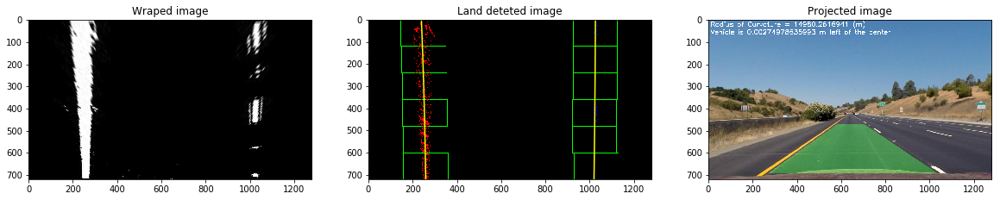

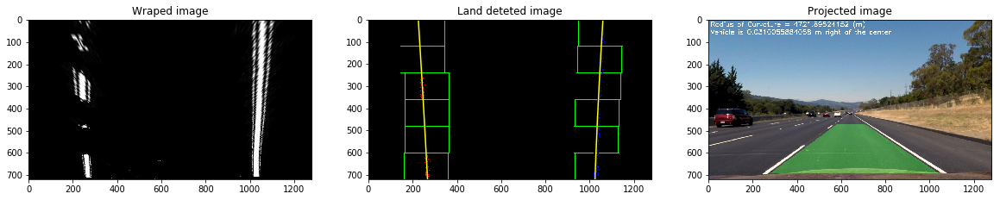

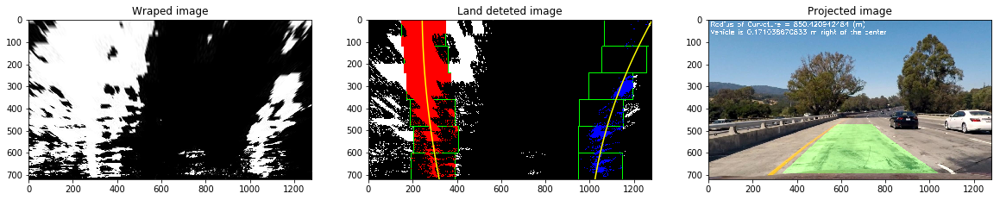

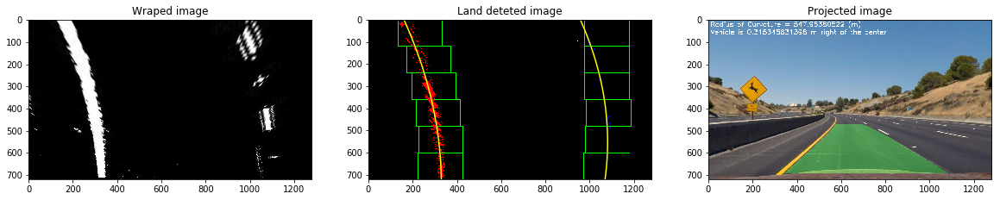

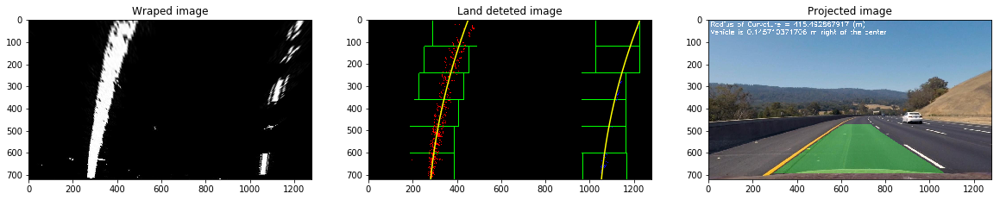

...

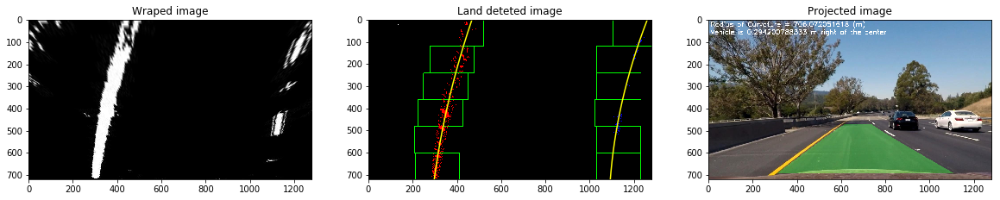

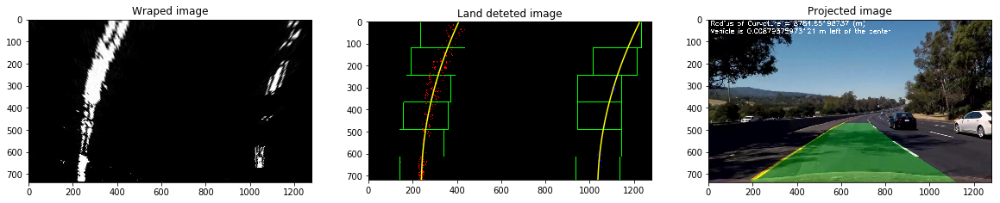

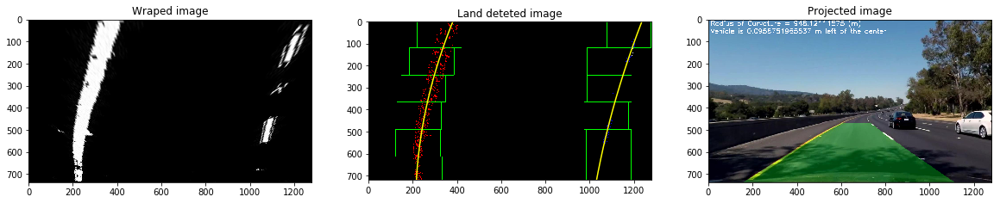

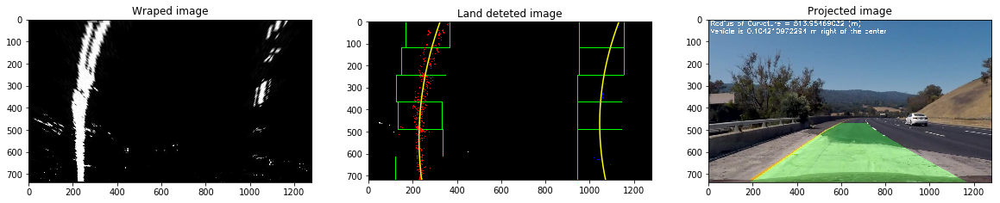

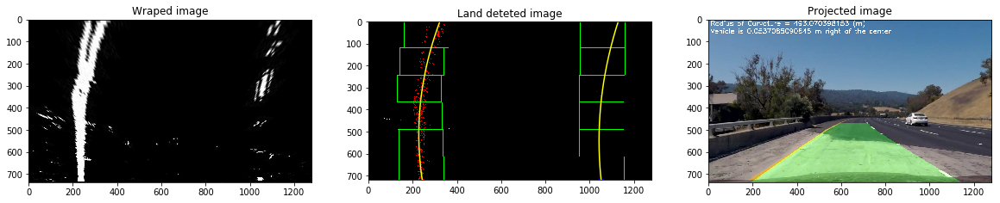

In [10]:
images = glob.glob('../output_images/warped_combined_*.jpg')
images_undist = glob.glob('../output_images/undist_*.jpg')

Minv = cv2.getPerspectiveTransform(dst, src)    
# Step through the list and find the lines
for fname,fname_undist in zip(images,images_undist):
    img = mpimg.imread(fname)
    undist = mpimg.imread(fname_undist)
    
    binary_warped = np.uint8(img/255)
    left_fit = None #np.array([0.000234215523e-04,  -4.01163553e-01,   4.02152640e+02])
    right_fit = None #np.array([4.03499309e-04,  -5.04786652e-01,   1.20659090e+03])
    result = detect_lane(binary_warped, undist, Minv, is_plotting=True, is_first_frame=True, left_fit=left_fit, right_fit=right_fit)
    

---
## Pipeline (Video)

<a id='step8'></a>
### Step 8 Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position

Below is the advanced lane finding method for the project video

In [11]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [12]:
import imageio
imageio.plugins.ffmpeg.download()

In [13]:
def process_image(img):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)

    # Step 2 Apply distortion correction to the raw image
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx) 
    
    # Step 3 Use color transforms, gradients, etc., to create a thresholded binary image
    kernel_size = 5
    color_binary, combined_binary = pipeline(undist)   
    combined_binary = np.uint8(combined_binary * 255)

    # Step 4 Apply a perspective transform to rectify binary image ("birds-eye view") 
    img_size = (undist.shape[1], undist.shape[0])
    src = np.float32(
        [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
        [((img_size[0] / 6) - 10), img_size[1]],
        [(img_size[0] * 5 / 6) + 40, img_size[1]],
        [(img_size[0] / 2 + 60), img_size[1] / 2 + 100]])
    dst = np.float32(
        [[(img_size[0] / 5), 0],
        [(img_size[0] / 5), img_size[1]],
        [(img_size[0] * 4 / 5), img_size[1]],
        [(img_size[0] * 4 / 5), 0]])
    
    warped, perspective_M = warper(combined_binary, src, dst)

    # Step 5 Detect lane pixels and fit to find the lane boundary
    binary_warped = np.uint8(warped/255)
    Minv = cv2.getPerspectiveTransform(dst, src) 
    result = detect_lane(binary_warped, undist, Minv, is_plotting=False)
    
    return result


In [14]:
white_output = '../project_video_out.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("../project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video ../project_video_out.mp4
[MoviePy] Writing video ../project_video_out.mp4


100%|█████████▉| 1260/1261 [33:04<00:00,  1.12it/s]    


[MoviePy] Done.
[MoviePy] >>>> Video ready: ../project_video_out.mp4 

CPU times: user 18min 13s, sys: 1min 54s, total: 20min 7s
Wall time: 33min 5s


In [15]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">4
</video>
""".format(white_output))

---
## Discussion
Here I'll talk about the approach I took, what techniques I used, what worked and why, where the pipeline might fail and how I might improve it if I were going to pursue this project further.

The pipeline successfully detected the lane area of the project video. During the implemetation, there are some problems that I faced in my implementation.
- I used color transforms and gradients to create a thresholded binary image. There are difficult extract clear lines in the images with large and dark shadow or image with very bright road. I used B-channel from LAB color space to extract yellow line and L-channel to extract white line. In addition, I combined gradient w.r.t direction x, gradient magnitude and gradient direction to get more sufficient edges. 
- I manually defined fixed src and dst points for the perspective transform which based on a test image with the straight lane. Sometimes, the perspective transform did not give a good result since the car run off the center of the lane and gave different view. For further improvement, I might develop auto-detection src and dst points algorithm for the perspective transform.
- Currently, I always did the blind search to detect lane pixels of frames. This made the lane boundary a litle bit fluctate when running on multiple frame. For further improvement, I will apply the lane pixel search based on the lane position of previous frames or using frame averaging for smooth lane detection.
- Currently, the combined thresholded binary image still contained noisy pixels of the sides of the lane. I might apply the region of interest technique, which will process the image inside the wanted region only.
